In [6]:
import cv2 #manipular imagenes
import numpy as np #operaciones numericas
import matplotlib.pyplot as plt #visualizar imagenes
from IPython.display import Image #mostrar imagenes en jupyter
import os #Para operaciones del sistema operativo
import random #Para operaciones aleatorias

In [13]:
#Definicion de funciones:
def find_blister_contour(img):
    # --- Convertir a escala de grises ---
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)




    # --- Suavizar ---
    blur = cv2.GaussianBlur(gray, (5,5), 0)

    # --- Bordes ---
    edges = cv2.Canny(blur, 50, 150)

    # --- Cerrar huecos para que el contorno sea más sólido ---
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (9,9))  
    closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)

    # --- Buscar contornos ---
    contours, _ = cv2.findContours(closed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # --- Seleccionar el contorno más grande ---
    blister_contour = max(contours, key=cv2.contourArea)

    return blister_contour

def recortar_blister(img, contour):
    x, y, w, h = cv2.boundingRect(contour)
    blister = img[y:y+h, x:x+w]
    return blister

# Mejorar iluminación usando clahe no conseguido
# con tophat mal tmb



# def detectar_cavidades_contornos(blister, min_area=800, circularity_thresh=(0.55, 1.25)):
    """
    Detecta cavidades de pastillas en un blister usando contornos filtrados por
    área y circularidad, evitando detecciones falsas por texto o textura del aluminio.

    Args:
        blister: imagen BGR del blister recortado
        min_area: área mínima en píxeles para considerar un contorno
        circularity_thresh: rango de circularidad aceptable (0-1)

    Retorna:
        img_contours: imagen con cavidades dibujadas
        num_cavidades: número de cavidades detectadas
        cavidades_props: lista de diccionarios con 'centro' y 'radio' aproximado
    """
    
    # blister_mask_full = find_blister_contour(blister)
    # blister2 = blister.copy()
    # blister2 = cv2.cvtColor(blister2, cv2.COLOR_BGR2GRAY)
    # cv2.drawContours(blister2, [blister_mask_full], -1,255, -1)
    
    # # Convertir a gris y suavizar
    # gray = cv2.cvtColor(blister, cv2.COLOR_BGR2GRAY)

    
    # #operaciones entre gray y blister2
    # #masked = cv2.absdiff(gray, blister2)

    # # iluminación mejorada solo para umbralizar
    # # para evitar que la máscara de contorno destruya la iluminación corregida
    # masked = cv2.bitwise_and(gray,blister2)
    # # ELIMINAMOS GRANO SIN PERDER FORMA CIRCULAR
    # masked = cv2.bilateralFilter(masked, 9, 75, 75)



    # blur = cv2.GaussianBlur(masked, (5,5), 0)

    # # UMBRAL ADAPTATIVO PARA MEJORAR DETECCIÓN
    # thresh = cv2.adaptiveThreshold(
    # blur,
    # 255,
    # cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    # cv2.THRESH_BINARY_INV,
    # 31,
    # 2
    # )

    # # MORFOLOGÍA PARA CERRAR HUECOS EN LAS CAVIDADES
    # kernel2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
    # thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel2)



    # # Encontrar contornos
    # contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # img_contours = blister.copy()
    # cavidades_props = []
    # for cnt in contours:
    #     area = cv2.contourArea(cnt)
    #     perimeter = cv2.arcLength(cnt, True)
    #     if perimeter == 0:
    #         continue
    #     circularity = 4*np.pi*(area/(perimeter**2))
    #     if circularity_thresh[0] <= circularity <= circularity_thresh[1] and area >= min_area:
    #         # Dibujar contorno
    #         cv2.drawContours(img_contours, [cnt], -1, (0,255,0), 2)
    #         # Aproximar centro y radio
    #         (x,y), radius = cv2.minEnclosingCircle(cnt)
    #         cavidades_props.append({'centro': (int(x), int(y)), 'radio': int(radius)})
    #         # Dibujar centro
    #         cv2.circle(img_contours, (int(x), int(y)), 2, (0,0,255), 3)

    # num_cavidades = len(cavidades_props)
    # print(f"Número de cavidades detectadas: {num_cavidades}")

    # return img_contours, num_cavidades, cavidades_props
def detectar_cavidades_contornos(blister, min_area=800, circularity_thresh=(0.55, 1.25)):
    """
    Detecta cavidades usando CLAHE y operaciones locales; usa find_blister_contour
    para obtener la máscara, pero aplica CLAHE sobre 'gray' para mejorar umbralización.
    """
    # 1) Obtener contorno externo del blister SIN CLAHE (función anterior)
    blister_mask_full = find_blister_contour(blister)
    if blister_mask_full is None:
        print("No se encontró contorno del blister")
        return blister.copy(), 0, []

    # 2) Crear máscara binaria limpia del blister (no sobreescribimos gray)
    h, w = blister.shape[:2]
    mask = np.zeros((h, w), dtype=np.uint8)
    cv2.drawContours(mask, [blister_mask_full], -1, 255, -1)  # white inside blister

    # 3) Convertir a gris ORIGINAL y aplicar CLAHE aquí (solo para cavidades)
    gray = cv2.cvtColor(blister, cv2.COLOR_BGR2GRAY)

    # Aplicar CLAHE únicamente para mejorar contraste interno
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    gray_clahe = clahe.apply(gray)

    # 4) Aplicar la máscara del blister sobre la imagen CLAHEada
    #    De este modo afuera del blister queda 0 y no afecta el adaptiveThreshold
    masked = cv2.bitwise_and(gray_clahe, mask)

    # 5) Filtrar ruido sin perder bordes
    masked = cv2.bilateralFilter(masked, 9, 75, 75)
    blur = cv2.GaussianBlur(masked, (5,5), 0)

    # 6) Umbral adaptativo sobre la versión CLAHEada+mascarada
    thresh = cv2.adaptiveThreshold(
        blur,
        255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        31,
        2
    )

    # 7) Morfología para cerrar huecos en cavidades (kernel elíptico)
    kernel2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel2)
    # puedes añadir un open pequeño para eliminar puntitos:
    # thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3)))

    # 8) Encontrar contornos (ahora sí dentro del blister)
    contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    img_contours = blister.copy()
    cavidades_props = []


    gray2 = cv2.cvtColor(blister, cv2.COLOR_BGR2GRAY)

    for cnt in contours:

        area = cv2.contourArea(cnt)
        perimeter = cv2.arcLength(cnt, True)
        if perimeter == 0:
            continue

        circularity = 4*np.pi*(area/(perimeter**2))

        if circularity_thresh[0] <= circularity <= circularity_thresh[1] and area >= min_area:

            # -----------------------
            #   CÍRCULO DETECTADO
            # -----------------------
            (x,y), radius = cv2.minEnclosingCircle(cnt)
            x, y, radius = int(x), int(y), int(radius)

            # =====================================
            #   🔍 NUEVO: CLASIFICAR POR INTENSIDAD
            # =====================================
            mask_circle = np.zeros_like(gray2, dtype=np.uint8)
            cv2.circle(mask_circle, (x,y), radius, 255, -1)

            pixel_values = gray2[mask_circle == 255]
            mean_intensity = np.mean(pixel_values)

            # umbral ajustable
            hay_pastilla = mean_intensity > 120

            # color según clasificación
            color = (0,255,0) if hay_pastilla else (0,0,255)

            # Dibujos
            cv2.circle(img_contours, (x,y), radius, color, 2)
            cv2.circle(img_contours, (x,y), 2, color, 3)

            # Guardar propiedades
            cavidades_props.append({
                'centro': (x, y),
                'radio': radius,
                'intensidad': float(mean_intensity),
                'hay_pastilla': hay_pastilla
            })

            

    num_cavidades = len(cavidades_props)
    print(f"Número de cavidades detectadas: {num_cavidades}")

    return img_contours, num_cavidades, cavidades_props


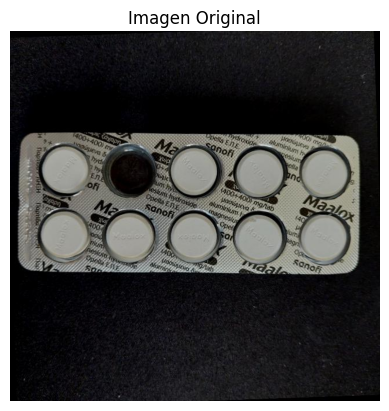

In [14]:
#--- Mostrar imagen original aleatoria ---
folder_path = "img_depurado" #Carpeta con imagenes de validacion
#Seleccionar imagen aleatoria de la carpeta ramdom.choice para elegir un elemento aleatorio de una lista 
# os.listdir para listar los archivos en la carpeta
imagen = random.choice(os.listdir(folder_path)) 
img = cv2.imread(os.path.join(folder_path, imagen)) #Leer la imagen seleccionada

#Ver imagen original
plt.figure()
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("Imagen Original")
plt.axis('off')  # Ocultar los ejes
plt.show()

Procesada imagen: ('20250225_151314_jpg.rf.4e652ec8f7c0f7de46f86140ceec4e88.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


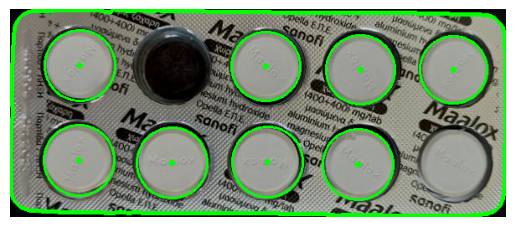

In [15]:
blister_contour = find_blister_contour(img)
# --- Dibujar contorno ---
img_contour = img.copy()
cv2.drawContours(img_contour, [blister_contour], -1, (0,255,0), 3)
print(f"Procesada imagen: {imagen, img_contour.shape}")

blister = recortar_blister(img_contour, blister_contour)

img_circles, num_cavidades, cavidades = detectar_cavidades_contornos(blister,min_area=1000, circularity_thresh=(0.7, 1.2))


plt.imshow(cv2.cvtColor(img_circles, cv2.COLOR_BGR2RGB))
plt.axis('off')  # Ocultar los ejes
plt.show()

In [16]:
def cargar_n_reales(ruta_reales):
    reales = {}
    with open(ruta_reales, "r") as f:
        for line in f:
            line = line.strip()

            # ignorar líneas vacías
            if not line:
                continue

            # ignorar líneas que no tengan ":" 
            if ":" not in line:
                print(f"⚠ Línea inválida ignorada: {line}")
                continue

            try:
                nombre, valores = line.split(":")
                vacias, _ = valores.strip("()").split(",")
                reales[nombre] = int(vacias)
            except Exception as e:
                print(f"⚠ Error procesando línea: {line}\n{e}")
                continue

    return reales

In [17]:
ruta_reales = "label_depurado2.txt"
reales = cargar_n_reales(ruta_reales)

total_cavidades = 10

correctos = 0
procesados = 0



Procesada imagen: ('20250224_153124_jpg.rf.3847578dfd66b817407e466c7874943d.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


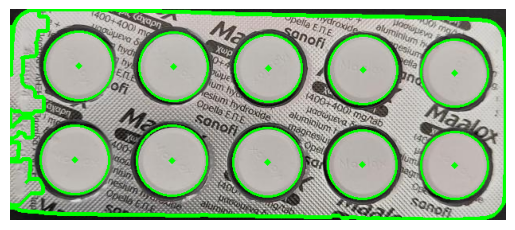

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153131_jpg.rf.9c402a72bffe6d996dba78c04995142b.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


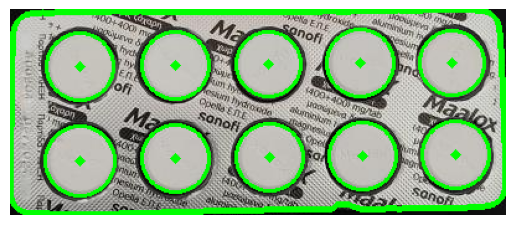

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153224_jpg.rf.0fa68392afccda00f29f736c35fd06b7.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


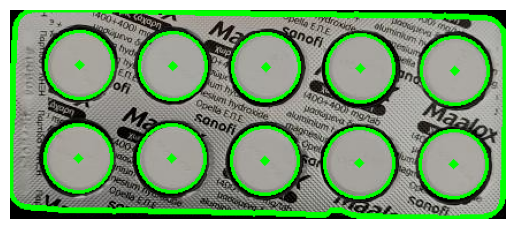

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153235_jpg.rf.122631a9a7650595c374f26234d17b6b.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


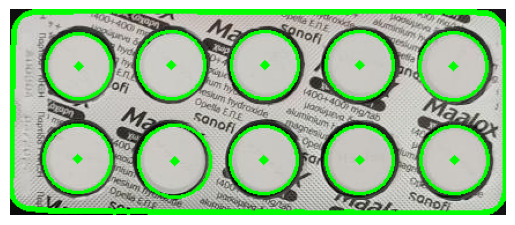

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153255_jpg.rf.3c06ba6e010a146fe14a3a5508ab60f3.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


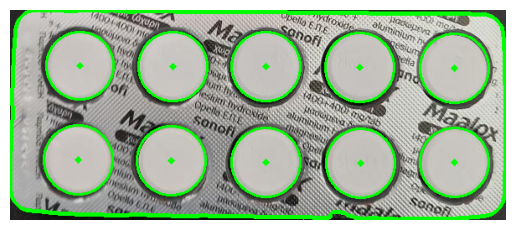

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153309_jpg.rf.e9ce0a9dbd806d0c5fce17e530921049.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


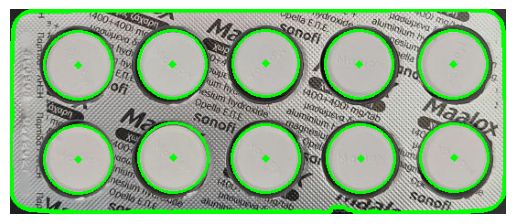

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153536_jpg.rf.b90fee575e0bd8430c0c8fc9f5dade0e.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


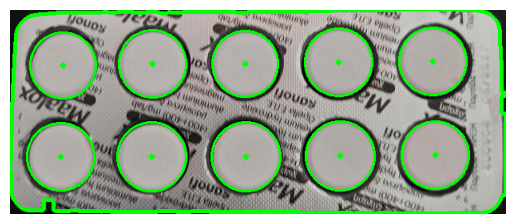

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153550_jpg.rf.173fabce4a93e19216e722feba55baea.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


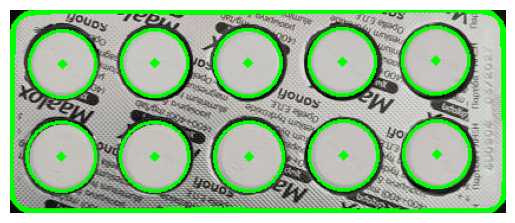

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153552_jpg.rf.30ae352663aca0cbe82aaf29bc79ac9a.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


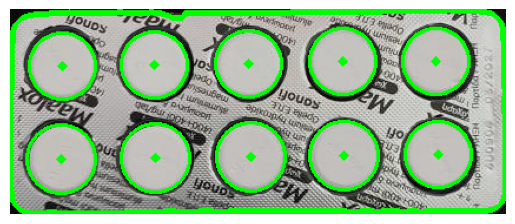

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153554_jpg.rf.e37fba83d295614302716f5a6331f32d.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


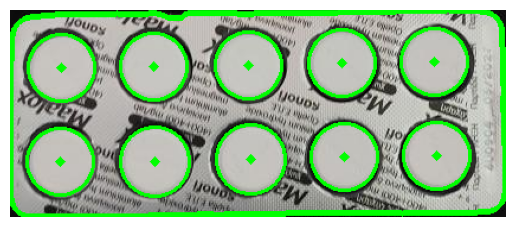

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153556_jpg.rf.992185cb04c58d164a9d4023adf5cc6e.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


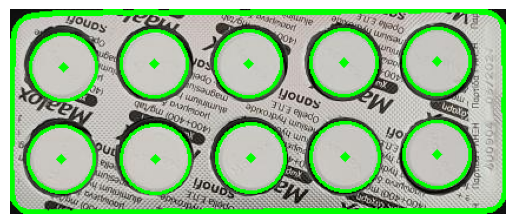

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153602_jpg.rf.482dc789a565f0abe770156c5a574a6d.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


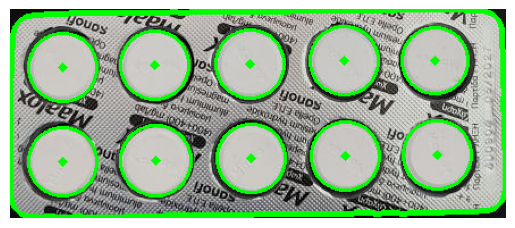

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153609_jpg.rf.7e75454f40fea3a01319db8ab18f9274.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


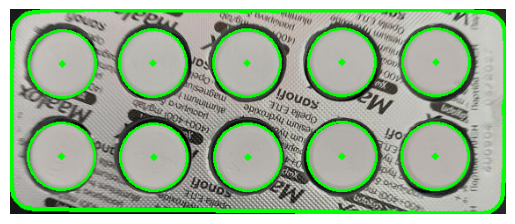

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153840_jpg.rf.6b49a945278ed4010761d21d67165d46.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


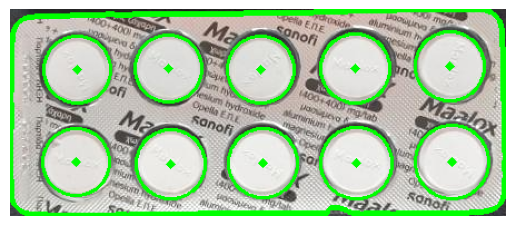

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_153904_jpg.rf.5275cb0dbc1085b0167e86e846ae4f3c.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


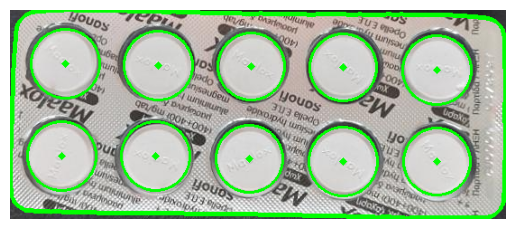

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_155804_jpg.rf.78db2607faf7d1e3436ca30c0e8522b0.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


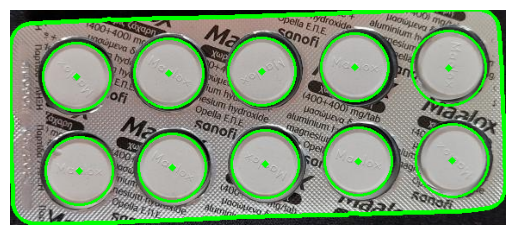

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_155804_jpg.rf.811657b022b706b29cd562a558ba1503.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


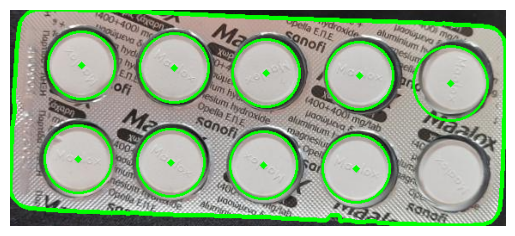

Cavidades vacías reales: 0, detectadas: 1
Detección incorrecta ❌
Procesada imagen: ('20250224_162133_jpg.rf.99df02cca8fc00e8728cf19dd9801c93.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


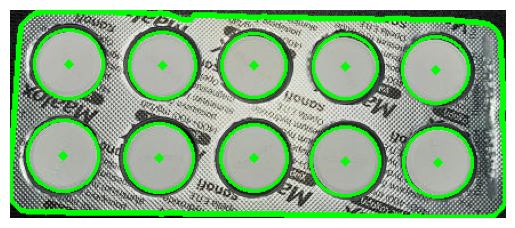

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_162139_jpg.rf.2c38053e427bc40ee19e01342f224532.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


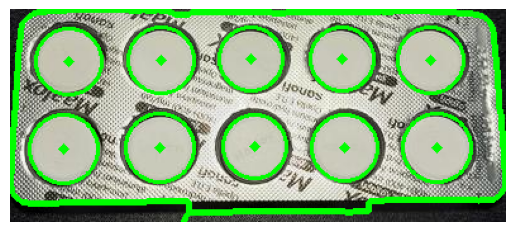

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_162154_jpg.rf.fed8f970380e36784e3e5b4adf7de2c3.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


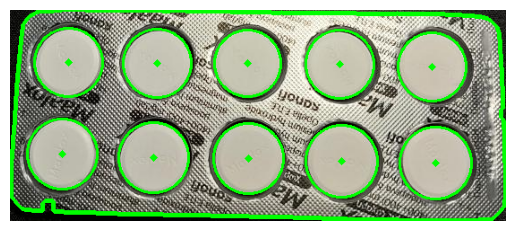

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_162158_jpg.rf.433034f16d7b7c2b373a1436e81c4b7a.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


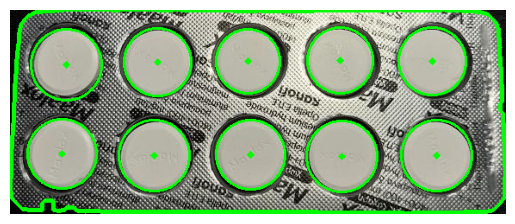

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_162205_jpg.rf.55dc24c9d9c67099904c3ca947b6584b.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


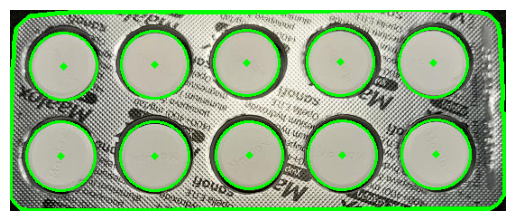

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163018_jpg.rf.072156abdc74665ab231a0de0c39ec4a.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


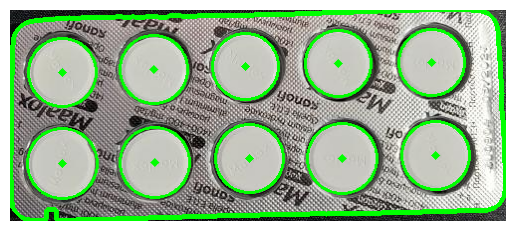

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163348_jpg.rf.be5b44247aeb54dd8211edc21fb67aae.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


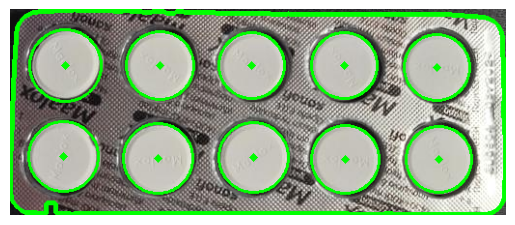

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163425_jpg.rf.ef59285acea1a0fd6ee263c20b9022c9.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


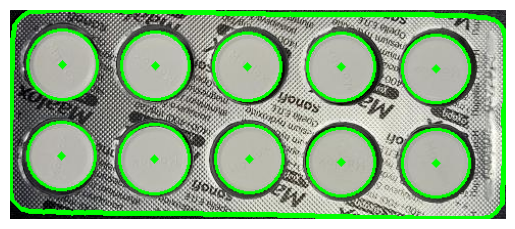

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163601_jpg.rf.47d7c720417bbe8324321e4e47ed09ee.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


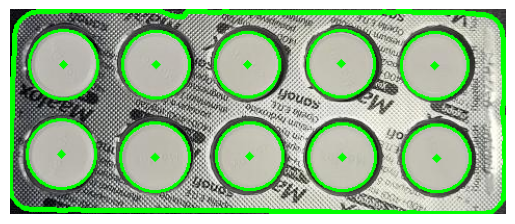

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163622_jpg.rf.80a0a76d386947ab948ae1b7b3e65ea5.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


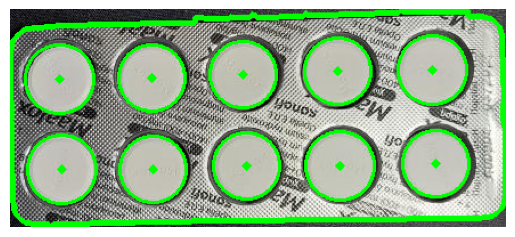

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163623_jpg.rf.dd776684eff28cb87a62483195eed2c4.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


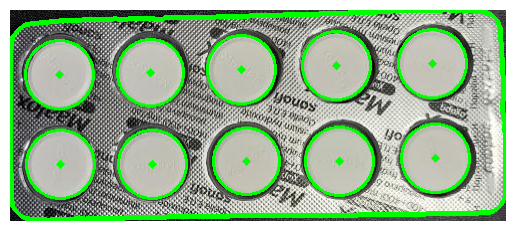

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163630_jpg.rf.6c7a9ed1d9c08768d7082676ff0a11ba.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


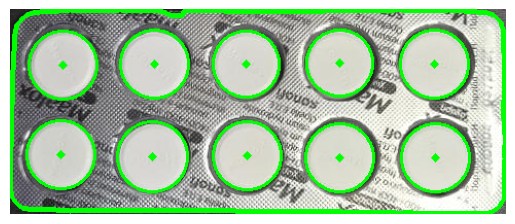

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163630_jpg.rf.c4cd49d3a523bde6ea430037ecf3c486.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


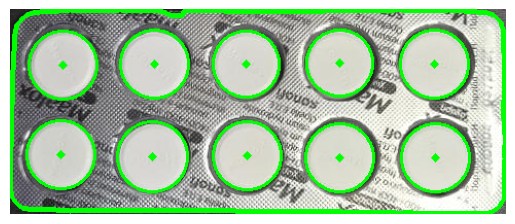

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163717_jpg.rf.479e9666066781ae35eaf5e986122334.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


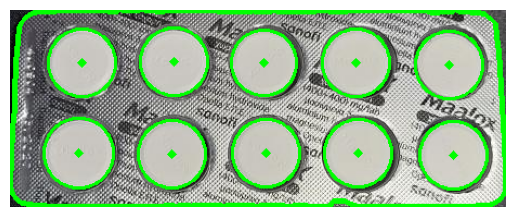

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_163759_jpg.rf.b68e618a90cc046b9f46e793bb60419d.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


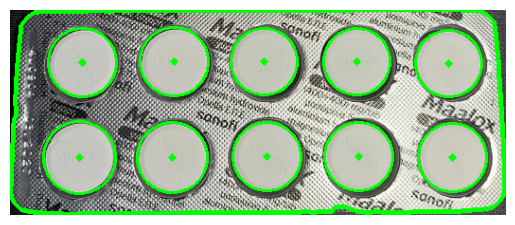

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164025_jpg.rf.03289b44303b633c5ad34a4badafa900.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


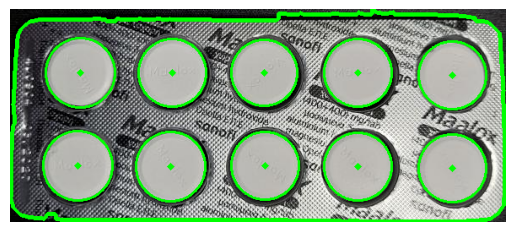

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164357_jpg.rf.d5431377c514e1fd4735aa85d9ea7d63.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


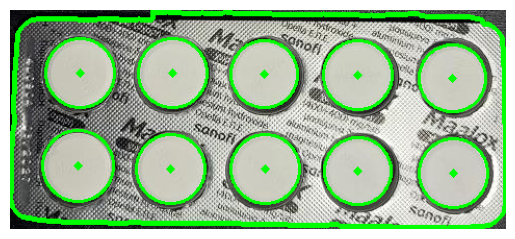

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164729_jpg.rf.99ca294a4a7ad22ae487ca6fc3293dc5.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


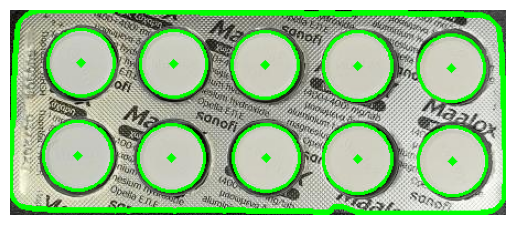

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164755_jpg.rf.fdd8003ca31775d4ed30584e92e57527.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


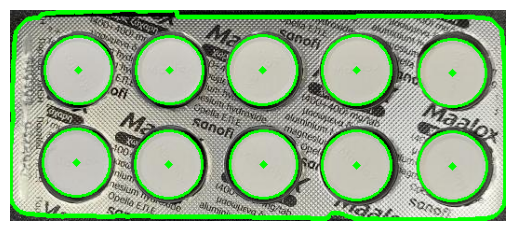

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164757_jpg.rf.e318a5947754916d5118657478bf443d.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


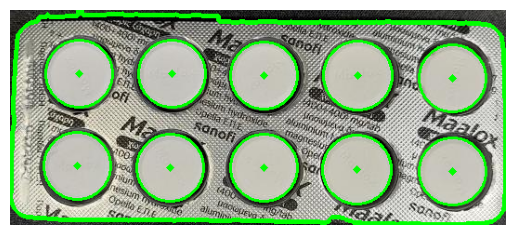

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164800_jpg.rf.71c40bc2fbcccf0b280d683a822ed0e8.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


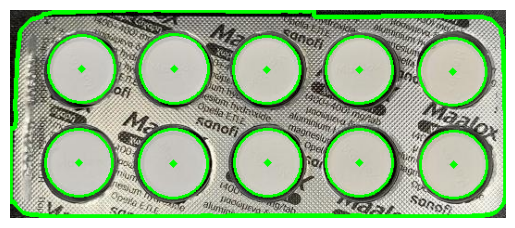

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164807_jpg.rf.5ca80fd5be48af123a470c53e00f3e30.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


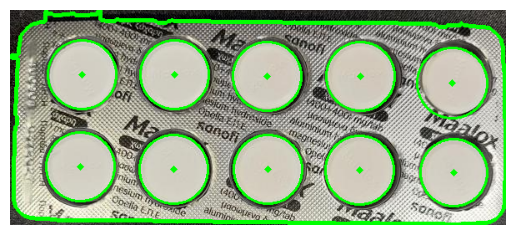

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164816_jpg.rf.3b3f7d599d7bdda0732683ad4554853c.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


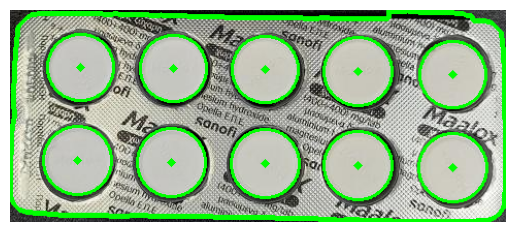

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164819_jpg.rf.f8a65c56c7214aa36145a7ff84b77100.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


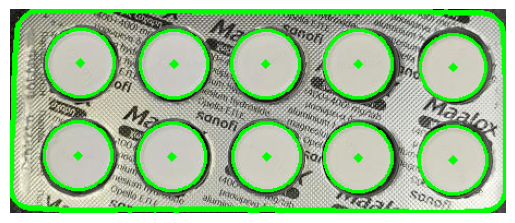

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_164823_jpg.rf.309662d6cd0e8302d3c6562d527b4353.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


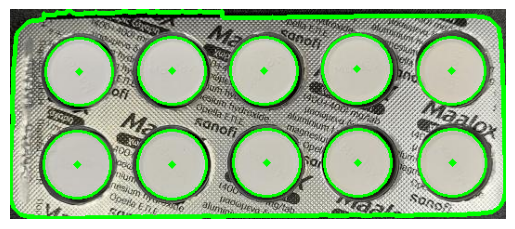

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250224_165021_jpg.rf.048d642ae1394dade8f11880b7cfeb56.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


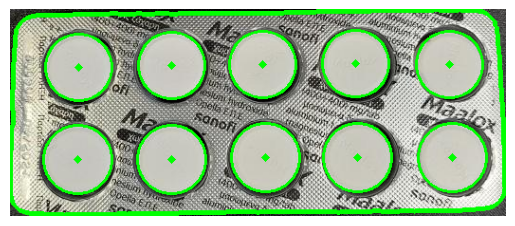

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250225_150119_jpg.rf.828ba3e2d817fa8285164929c8b94e07.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


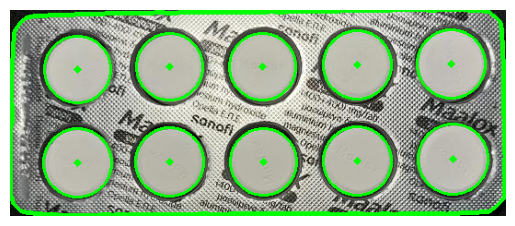

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250225_150124_jpg.rf.b593f1d9a18ed31fcec4b1b2526e6d95.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


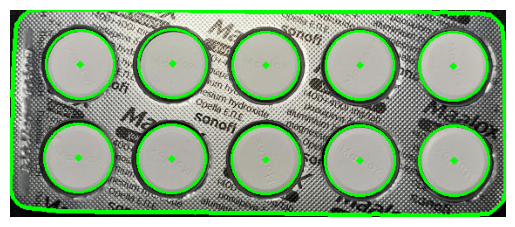

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250225_150913_jpg.rf.735d2986074d8cbd6784dac70928c09f.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


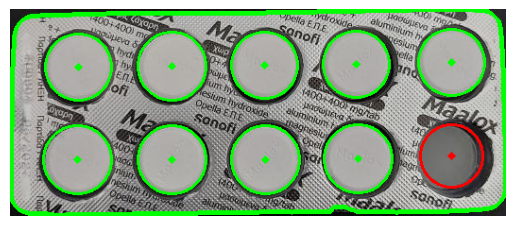

Cavidades vacías reales: 1, detectadas: 0
Detección incorrecta ❌
Procesada imagen: ('20250225_150948_jpg.rf.471053297abfa0e6962fc533e7c3eb6f.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


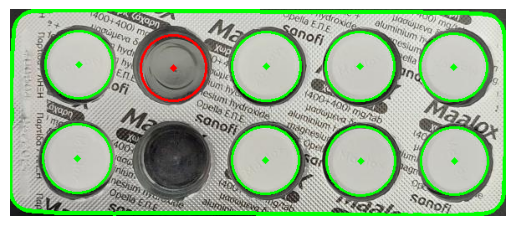

Cavidades vacías reales: 2, detectadas: 1
Detección incorrecta ❌
Procesada imagen: ('20250225_150956_jpg.rf.c120be6fdacd920f7b8ff0be4f6c83ed.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


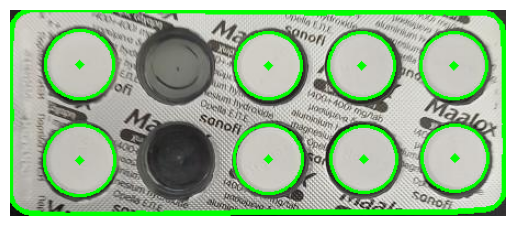

Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅
Procesada imagen: ('20250225_151103_jpg.rf.46f3abe0cb9f01b41428cfce36f545c1.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


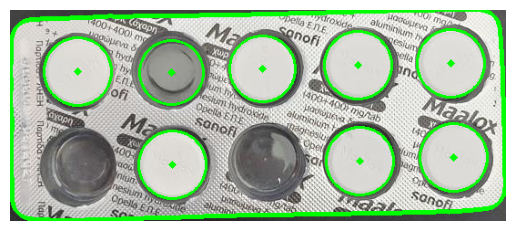

Cavidades vacías reales: 3, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_151103_jpg.rf.a7304fa06ec2b1297429d20f7d95062e.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


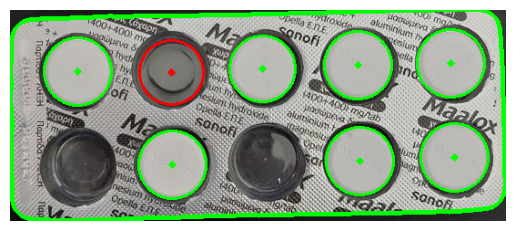

Cavidades vacías reales: 3, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_151137_jpg.rf.1c571d7f6c45c58fc48d196b5f8c056b.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


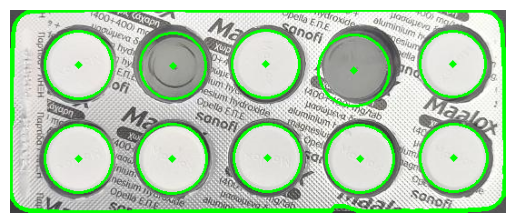

Cavidades vacías reales: 2, detectadas: 0
Detección incorrecta ❌
Procesada imagen: ('20250225_151139_jpg.rf.c95cb5a6d7aa80839538dd151dea63e4.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


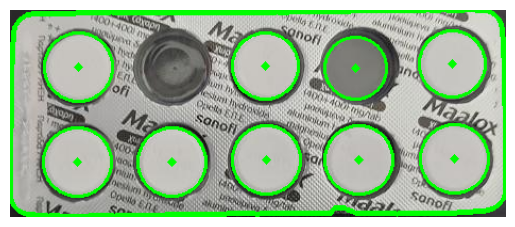

Cavidades vacías reales: 2, detectadas: 1
Detección incorrecta ❌
Procesada imagen: ('20250225_151217_jpg.rf.0680d2826f9d9d4199e3f17d6d759909.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


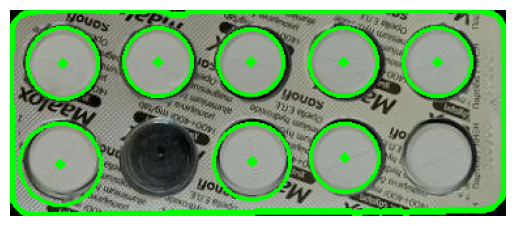

Cavidades vacías reales: 1, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_151245_jpg.rf.83267c2741ec28018396ec35f5f9e2f3.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


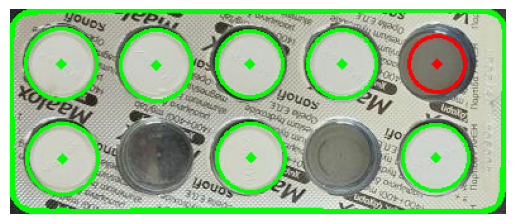

Cavidades vacías reales: 3, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_151254_jpg.rf.0e7bcfc8052168143bd6572657baaf1a.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


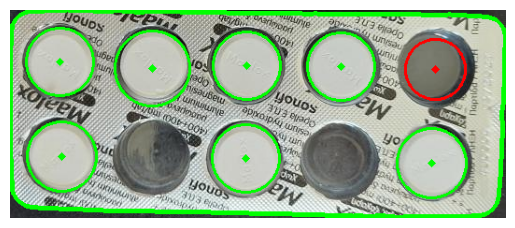

Cavidades vacías reales: 3, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_151314_jpg.rf.4e652ec8f7c0f7de46f86140ceec4e88.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


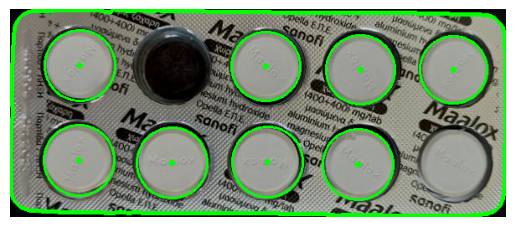

Cavidades vacías reales: 1, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_151540_jpg.rf.4a61307bacfb8f380afb439a4df38ca1.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


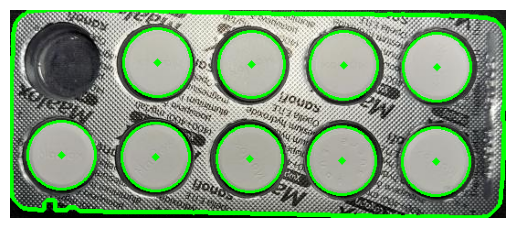

Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅
Procesada imagen: ('20250225_151543_jpg.rf.709b0ce931a67fb1eefae042b38697d1.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


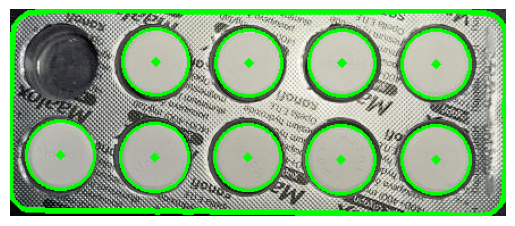

Procesada imagen: ('20250225_151859_jpg.rf.062436a1768689c95e016f40c2dd50a8.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


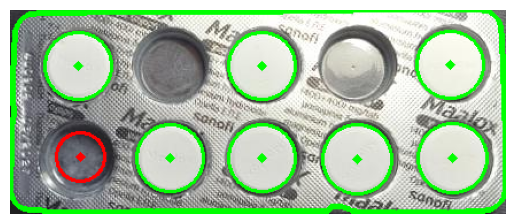

Cavidades vacías reales: 3, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_152024_jpg.rf.1ae8e1766afef1286f443e0868ba6c23.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


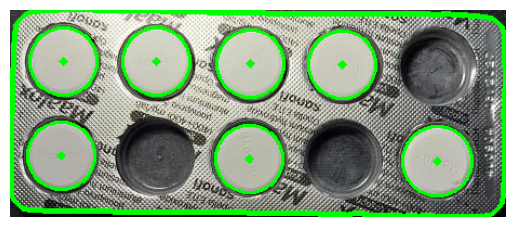

Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅
Procesada imagen: ('20250225_154108_jpg.rf.fd0abdd51d8af90df75d79419f96d5f5.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


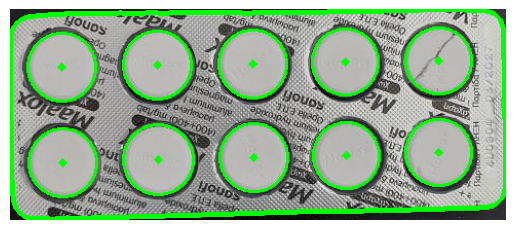

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250225_154112_jpg.rf.12744b95534d43330cde2165ffa20e76.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


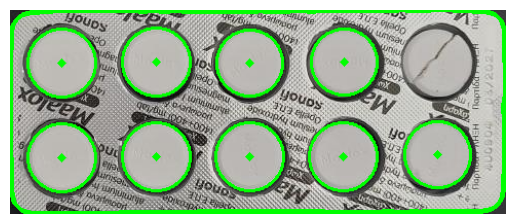

Cavidades vacías reales: 0, detectadas: 1
Detección incorrecta ❌
Procesada imagen: ('20250225_154404_jpg.rf.494a7871e901083dbcb8b7393a4711be.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


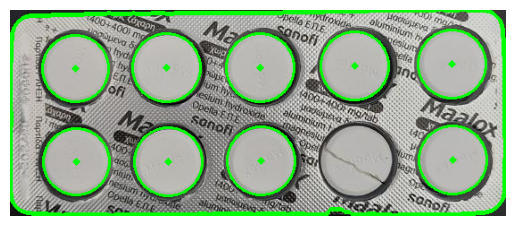

Cavidades vacías reales: 0, detectadas: 1
Detección incorrecta ❌
Procesada imagen: ('20250225_154528_jpg.rf.371f38e4c0a2aff26016b3427ddb0b25.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


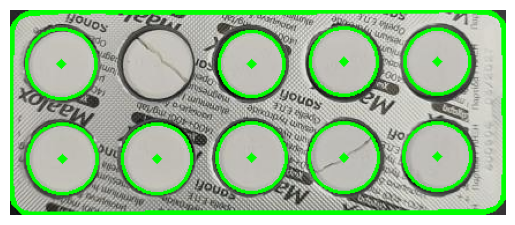

Cavidades vacías reales: 0, detectadas: 1
Detección incorrecta ❌
Procesada imagen: ('20250225_161141_jpg.rf.5574a442c3ae9aab79708b27b7541948.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


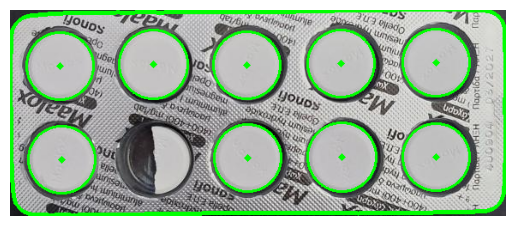

Cavidades vacías reales: 0, detectadas: 1
Detección incorrecta ❌
Procesada imagen: ('20250225_161304_jpg.rf.b57658709e5902fd290411fbad65657d.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


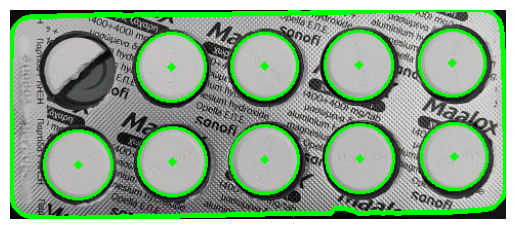

Cavidades vacías reales: 0, detectadas: 1
Detección incorrecta ❌
Procesada imagen: ('20250225_161552_jpg.rf.9ba490255f38f38e31a0524862161563.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


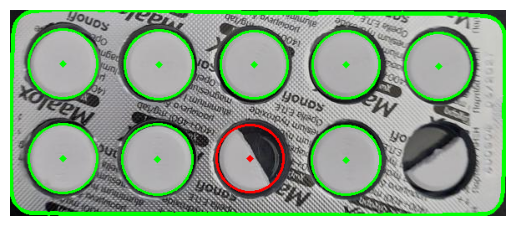

Cavidades vacías reales: 0, detectadas: 1
Detección incorrecta ❌
Procesada imagen: ('20250225_164532_jpg.rf.61ffd46aaa9573294494a0b18fc54a66.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


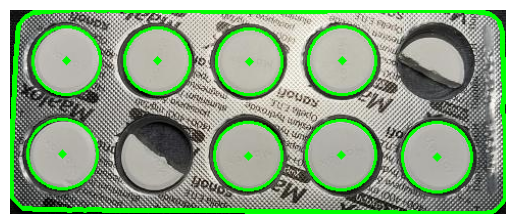

Cavidades vacías reales: 0, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_165624_jpg.rf.1e4a8832a7e0f141efad97260b9c732d.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


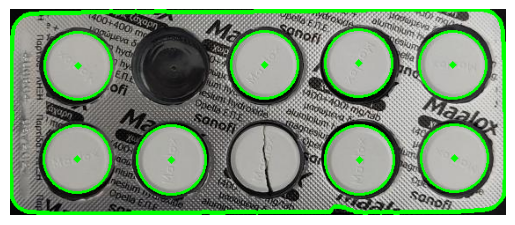

Cavidades vacías reales: 1, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_165928_jpg.rf.90f291475d3fe4f2009933e1191bdb6e.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


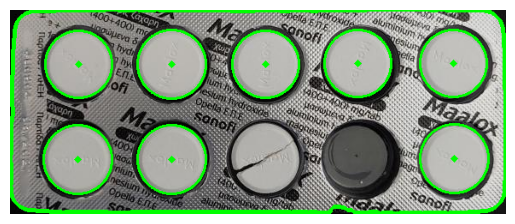

Cavidades vacías reales: 1, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_170045_jpg.rf.b1e64bd64417c5964042f2958d2c4eff.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


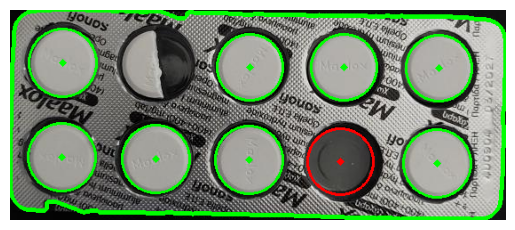

Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅
Procesada imagen: ('20250225_170053_jpg.rf.dcbb4f70eff7f4529a2b7b8a1e8445c5.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


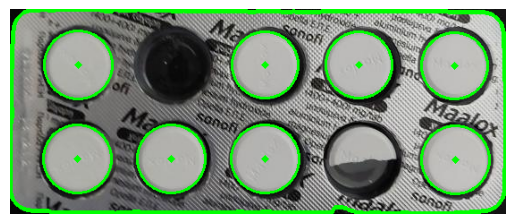

Cavidades vacías reales: 1, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_170111_jpg.rf.97d8a1e20025d109dc89e6a0659353e1.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


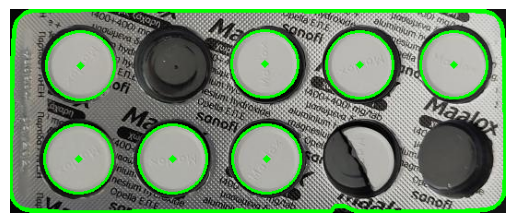

Cavidades vacías reales: 2, detectadas: 3
Detección incorrecta ❌
Procesada imagen: ('20250225_170526_jpg.rf.003ebc0d88afd130afb3385ee759fcca.jpg', (640, 640, 3))
Número de cavidades detectadas: 6


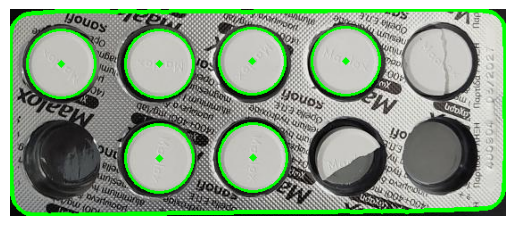

Cavidades vacías reales: 2, detectadas: 4
Detección incorrecta ❌
Procesada imagen: ('20250225_170642_jpg.rf.679b22da021ece3d786c4781cb4f8cb4.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


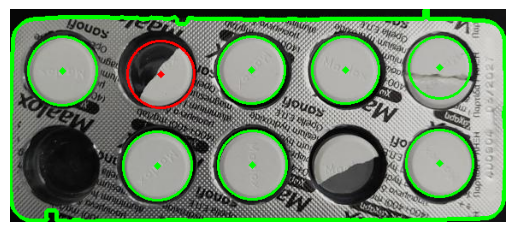

Cavidades vacías reales: 1, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_171024_jpg.rf.97c270f659864f7acb5568b7ae2f068b.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


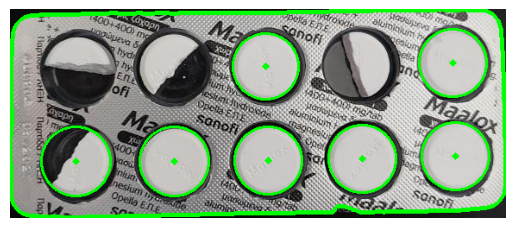

Cavidades vacías reales: 0, detectadas: 3
Detección incorrecta ❌
Procesada imagen: ('20250225_171657_jpg.rf.42b689580e5dd270e391c45293083ab7.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


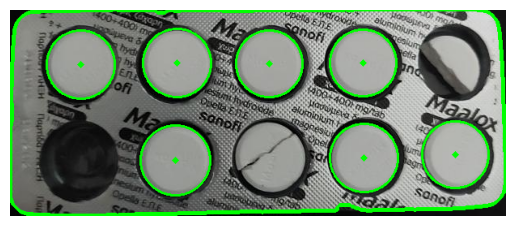

Cavidades vacías reales: 1, detectadas: 3
Detección incorrecta ❌
Procesada imagen: ('20250225_171725_jpg.rf.9030d574488045eedb55112192a56bb2.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


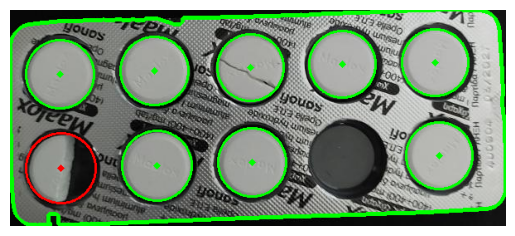

Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅
Procesada imagen: ('20250225_171734_jpg.rf.7a448fb806ae22762e1fa55a4b515633.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


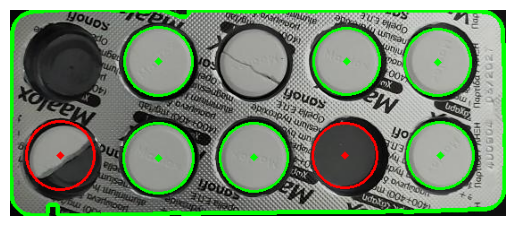

Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅
Procesada imagen: ('20250225_171749_jpg.rf.bcfeef21f8c4e541914265f8faf79fb2.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


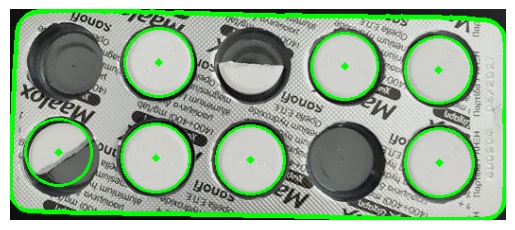

Cavidades vacías reales: 2, detectadas: 3
Detección incorrecta ❌
Procesada imagen: ('20250225_171805_jpg.rf.3e4e56eb7116a5bccfa145fe4c74a3ab.jpg', (640, 640, 3))
Número de cavidades detectadas: 8


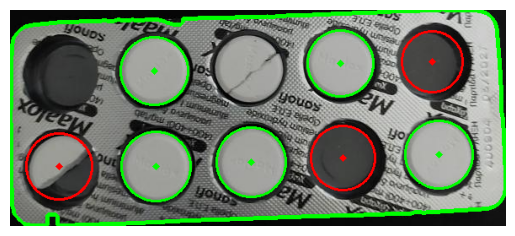

Cavidades vacías reales: 3, detectadas: 2
Detección incorrecta ❌
Procesada imagen: ('20250225_171848_jpg.rf.a63d395f50938a9019e634b1e15b15a1.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


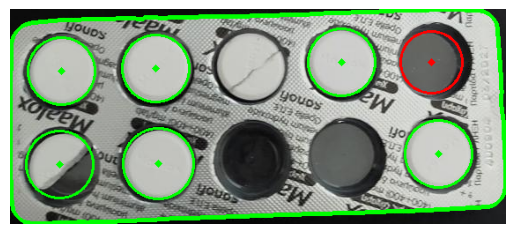

Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅
Procesada imagen: ('20250312_165803_jpg.rf.b23627621808796f3a5768fa962a831f.jpg', (640, 640, 3))
Número de cavidades detectadas: 10


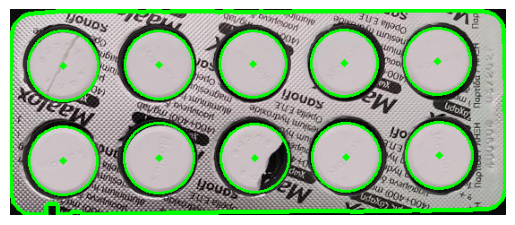

Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅
Procesada imagen: ('20250312_171405_jpg.rf.f9912a7abc226718ea46235a99d1f1b4.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


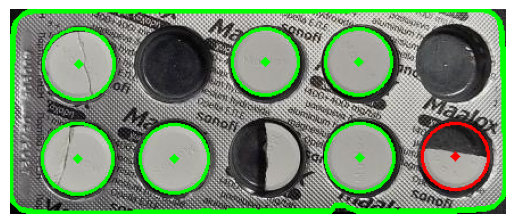

Cavidades vacías reales: 2, detectadas: 3
Detección incorrecta ❌
Procesada imagen: ('20250312_171509_jpg.rf.eeb91672439923aff235e176cd1e026f.jpg', (640, 640, 3))
Número de cavidades detectadas: 6


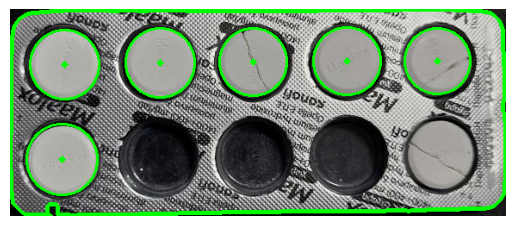

Cavidades vacías reales: 3, detectadas: 4
Detección incorrecta ❌
Procesada imagen: ('20250312_171529_jpg.rf.8e9d3150799d6e5e0a6ceed59bc58a84.jpg', (640, 640, 3))
Número de cavidades detectadas: 5


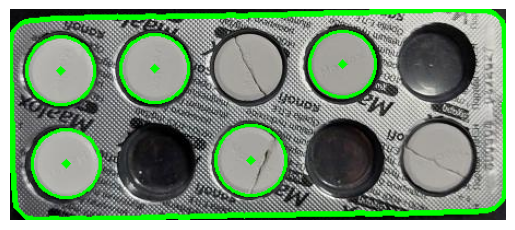

Cavidades vacías reales: 3, detectadas: 5
Detección incorrecta ❌
Procesada imagen: ('20250312_171539_jpg.rf.1add4b5396aba0cecf9e72546887c1aa.jpg', (640, 640, 3))
Número de cavidades detectadas: 5


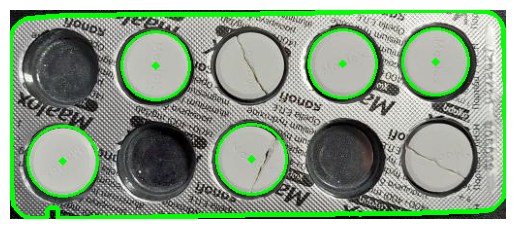

Cavidades vacías reales: 3, detectadas: 5
Detección incorrecta ❌
Procesada imagen: ('20250312_171642_jpg.rf.385bb55d9b323381cd7ff62d30d99092.jpg', (640, 640, 3))
Número de cavidades detectadas: 4


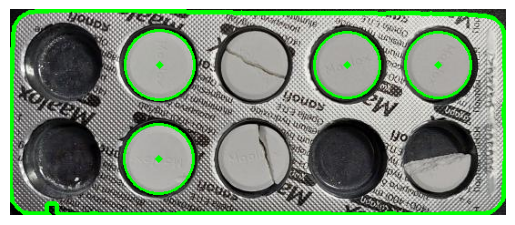

Cavidades vacías reales: 3, detectadas: 6
Detección incorrecta ❌
Procesada imagen: ('20250312_171700_jpg.rf.3c726cccd70bddc558b2b278c5bd284c.jpg', (640, 640, 3))
Número de cavidades detectadas: 6


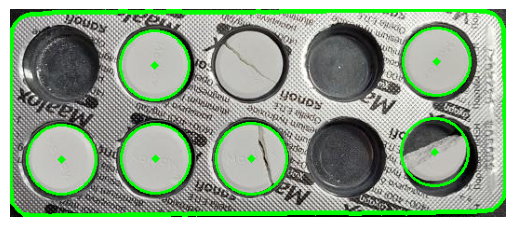

Cavidades vacías reales: 3, detectadas: 4
Detección incorrecta ❌
Procesada imagen: ('20250312_171824_jpg.rf.1134a98874918268298d8871aa33588a.jpg', (640, 640, 3))
Número de cavidades detectadas: 6


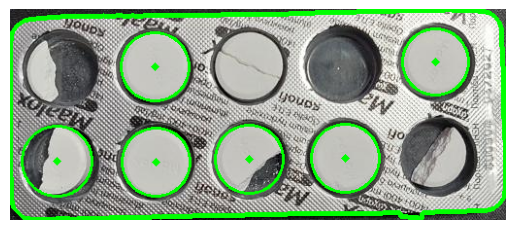

Cavidades vacías reales: 1, detectadas: 4
Detección incorrecta ❌
Procesada imagen: ('20250312_172022_jpg.rf.2c3f0762f8e452abc9a26f1461adcdce.jpg', (640, 640, 3))
Número de cavidades detectadas: 5


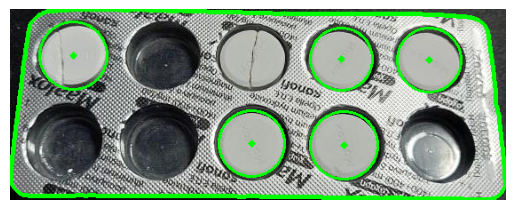

Cavidades vacías reales: 4, detectadas: 5
Detección incorrecta ❌
Procesada imagen: ('20250312_172359_jpg.rf.60234149154ea84176086082f3682819.jpg', (640, 640, 3))
Número de cavidades detectadas: 6


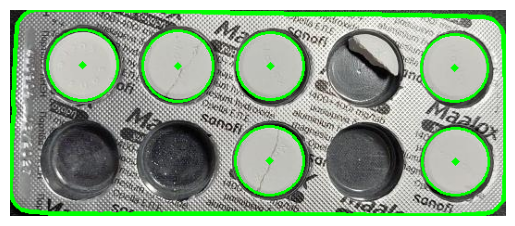

Cavidades vacías reales: 3, detectadas: 4
Detección incorrecta ❌
Procesada imagen: ('20250312_172712_jpg.rf.21380d295220517e61e78e18e8b2ab18.jpg', (640, 640, 3))
Número de cavidades detectadas: 6


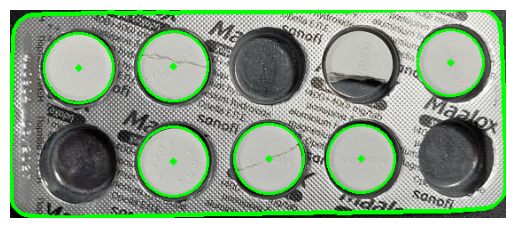

Cavidades vacías reales: 3, detectadas: 4
Detección incorrecta ❌
Procesada imagen: ('20250312_173113_jpg.rf.6eb41a18735d11eb5db67be57a921f32.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


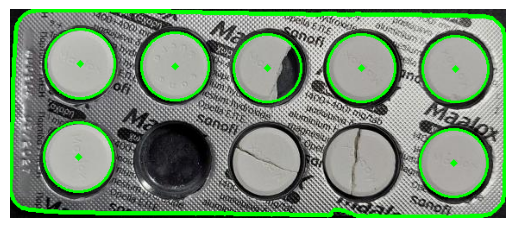

Cavidades vacías reales: 1, detectadas: 3
Detección incorrecta ❌
Procesada imagen: ('20250312_173454_jpg.rf.d260cc844542c7f0e853c212cc66fcfb.jpg', (640, 640, 3))
Número de cavidades detectadas: 6


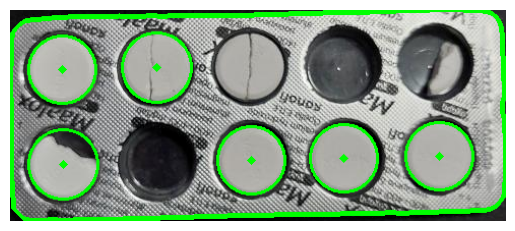

Cavidades vacías reales: 2, detectadas: 4
Detección incorrecta ❌
Procesada imagen: ('20250312_173631_jpg.rf.7c0f651e5b870507a6bb587e70c89a22.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


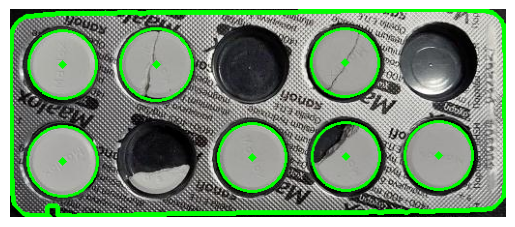

Cavidades vacías reales: 2, detectadas: 3
Detección incorrecta ❌
Procesada imagen: ('20250312_173711_jpg.rf.1573423577f218f012d5df2c93997d9c.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


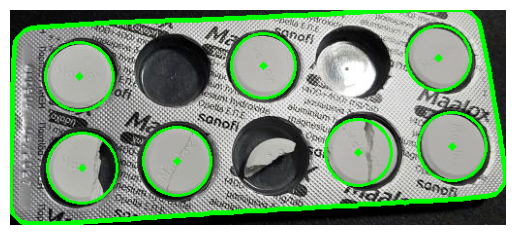

Cavidades vacías reales: 2, detectadas: 3
Detección incorrecta ❌
Procesada imagen: ('20250312_173844_jpg.rf.e0363150be9ff3d434ab98ac8774b22b.jpg', (640, 640, 3))
Número de cavidades detectadas: 9


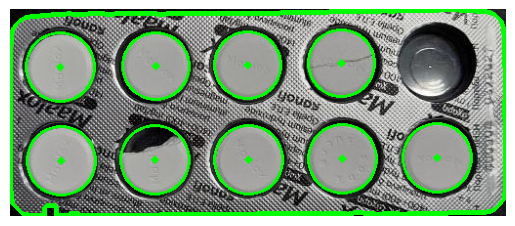

Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅
Procesada imagen: ('20250312_173916_jpg.rf.385f793dab7e08b0c6124c6aeb99d0be.jpg', (640, 640, 3))
Número de cavidades detectadas: 6


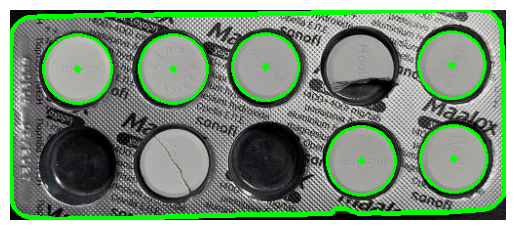

Cavidades vacías reales: 2, detectadas: 4
Detección incorrecta ❌
Procesada imagen: ('20250312_173925_jpg.rf.b50ba8fa6b978d59365b5b4590a8abc1.jpg', (640, 640, 3))
Número de cavidades detectadas: 7


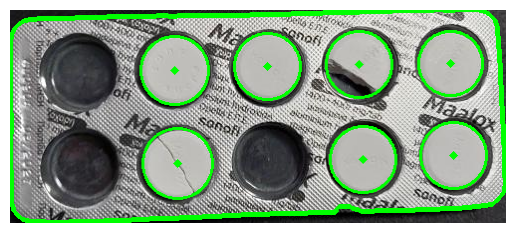

Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅
Imágenes procesadas: 100, detecciones correctas: 55, precisión: 55.00%


In [18]:
image_folder = "img_depurado"
for filename in os.listdir(image_folder):
    if filename.endswith(".jpg") or filename.endswith(".png"):

        procesados += 1

        image_path = os.path.join(image_folder, filename) #ruta completa
        img = cv2.imread(image_path) #cargar imagen

        blister_contour = find_blister_contour(img)

        # --- Dibujar contorno ---
        img_contour = img.copy()
        cv2.drawContours(img_contour, [blister_contour], -1, (0,255,0), 3)
        print(f"Procesada imagen: {filename, img_contour.shape}")

        blister = recortar_blister(img_contour, blister_contour)
        
        img_circles, num_cavidades, cavidades = detectar_cavidades_contornos(blister,min_area=1000, circularity_thresh=(0.7, 1.2))
      

        plt.imshow(cv2.cvtColor(img_circles, cv2.COLOR_BGR2RGB))
        plt.axis('off')  # Ocultar los ejes
        plt.show()
        #cv2.imshow("Blister detectado", img_contour)


        # Comparación con reales
        vacias_reales = reales.get(filename, None)

        if vacias_reales is not None:
            vacias_detectadas = total_cavidades - num_cavidades
            print(f"Cavidades vacías reales: {vacias_reales}, detectadas: {vacias_detectadas}")

            if vacias_reales == vacias_detectadas:
                correctos += 1
                print("Detección correcta ✅")
            else:
                print("Detección incorrecta ❌")


print(f"Imágenes procesadas: {procesados}, detecciones correctas: {correctos}, precisión: {correctos/procesados*100:.2f}%")
